In [12]:
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.resnet50 import decode_predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import json
import cv2
import random
import sys
import os
import torch
from PIL import Image
import matplotlib.pyplot as plt
# Get the absolute path of the src folder

sys.path.append(os.path.abspath("../src"))

from utils_attack import compute_psnr, compute_ssim, compute_msssim, eval_psnr_ssim_msssim, bytearray_to_bits
from regen_pipe import ReSDPipeline
from regen_attack import DiffWMAttacker


In [13]:
wm_text = 'test'
device = 'cuda:0'
print_width = 50

In [14]:
pipe = ReSDPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16, variant="fp16")
pipe.set_progress_bar_config(disable=True)
pipe.to(device)
print('Finished loading model')

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/opt/conda/lib/python3.11/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Finished loading model


In [15]:
from blackbox import verify_watermark

In [16]:
from utils_blackbox import show_image, preprocess_image, clip_eps, get_label, plot_combined_histogram


In [19]:
attackers = {
    'diff_attacker_60': DiffWMAttacker(pipe, batch_size=5, noise_step=60, captions={})
}

Diffuse attack initialized with noise step 60 and use prompt 0


In [7]:
# attacker_name = "diff_attacker_60"
# attacker = attackers[attacker_name]   # Select the attacker

# print('*' * print_width)
# print(f'Attacking PGD Blackbox Watermark with {attacker_name}')

# # Define paths for the input and output of the attack
# watermarked_img_path = "../output/blackbox_epsilon_testing/epsilon_7.jpg"  # Input image

# attacked_img_path = "../output/original_panda_attacked.jpg"

# # Move attacker model to CUDA if available
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# attacker.pipe.to(device)  # Ensure the model is on the right device

# # Apply the attack
# attacker.attack([watermarked_img_path], [attacked_img_path])

# print('Finished attacking')


In [17]:
resnet50 = tf.keras.applications.ResNet50(weights="imagenet", include_top=True, classifier_activation=None)


In [9]:
# original_image_path = "../examples/panda.jpg"
# attacked_img_path = "../output/original_panda_attacked.jpg"


In [10]:
# sample_image_org = show_image(original_image_path)
# preprocessed_image_org = preprocess_image(sample_image_org)
# image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)

# sample_image_att = show_image(attacked_img_path)
# preprocessed_image = preprocess_image(sample_image_att)
# image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)

# original_logits = resnet50.predict(preprocess_input(image_tensor_org))
# attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

In [11]:
# verify_watermark(original_logits, attacked_logits, [726, 264, 428, 190])

Processing image: epsilon_29.jpg
29
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 48.98it/s]


Finished attacking: epsilon_29.jpg


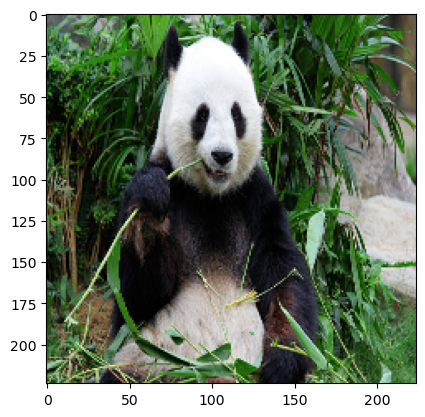

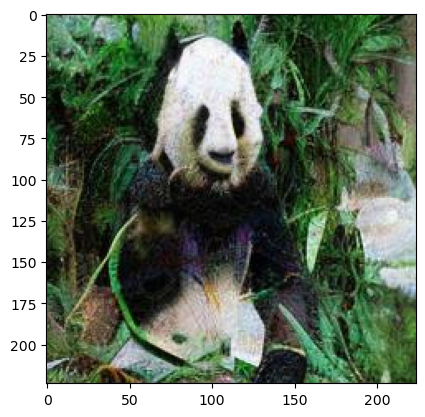

2025-03-09 18:08:10.910225: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


1/1 [==============================] - 0s 44ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.55087 | Logit Diff: 0.57830
Label: 264 | Logit Before: 3.17343 | Logit After: 0.97912 | Logit Diff: -2.19431
Label: 428 | Logit Before: 4.07258 | Logit After: 3.63961 | Logit Diff: -0.43297
Label: 190 | Logit Before: 1.40211 | Logit After: 3.73510 | Logit Diff: 2.33299
Average Logit Difference: 0.07100
Positive Percentage: 50.00%
Verification Status: Verified
True
0.07100331783294678
Processing image: epsilon_27.jpg
27
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 75.56it/s]


Finished attacking: epsilon_27.jpg


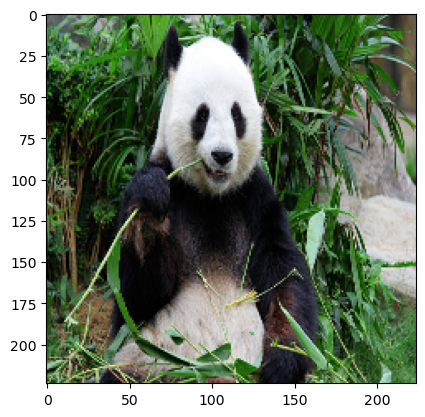

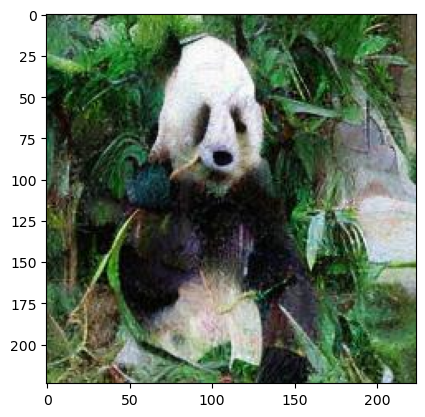

1/1 [==============================] - 0s 54ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.50720 | Logit Diff: 1.62197
Label: 264 | Logit Before: 3.17343 | Logit After: 2.56850 | Logit Diff: -0.60494
Label: 428 | Logit Before: 4.07258 | Logit After: 3.93546 | Logit Diff: -0.13712
Label: 190 | Logit Before: 1.40211 | Logit After: 6.65798 | Logit Diff: 5.25587
Average Logit Difference: 1.53395
Positive Percentage: 50.00%
Verification Status: Verified
True
1.5339460968971252
Processing image: epsilon_20.jpg
20
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 59.29it/s]


Finished attacking: epsilon_20.jpg


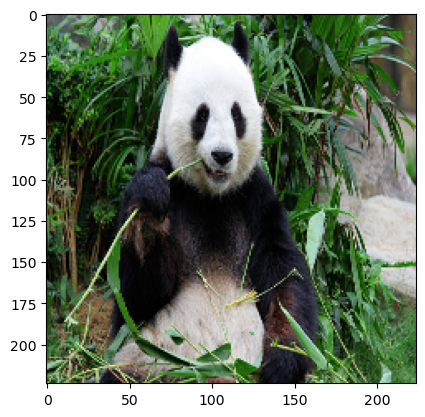

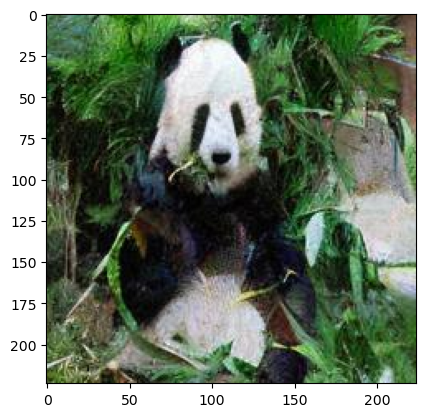

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.72005 | Logit Diff: 0.40912
Label: 264 | Logit Before: 3.17343 | Logit After: 2.55209 | Logit Diff: -0.62134
Label: 428 | Logit Before: 4.07258 | Logit After: 3.52922 | Logit Diff: -0.54336
Label: 190 | Logit Before: 1.40211 | Logit After: 3.66715 | Logit Diff: 2.26504
Average Logit Difference: 0.37737
Positive Percentage: 50.00%
Verification Status: Verified
True
0.37736570835113525
Processing image: epsilon_15.jpg
15
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 94.16it/s]


Finished attacking: epsilon_15.jpg


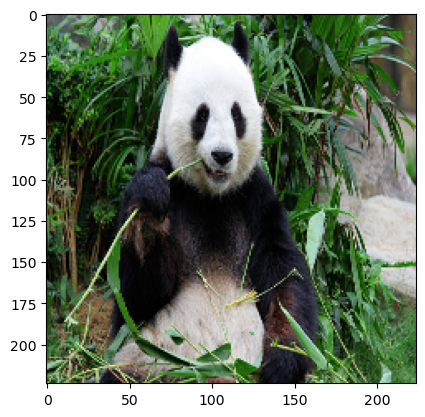

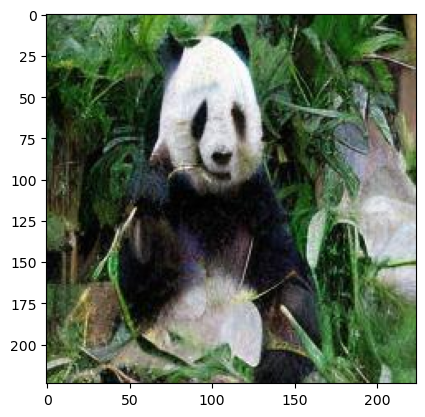

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.52170 | Logit Diff: 1.60747
Label: 264 | Logit Before: 3.17343 | Logit After: 2.02738 | Logit Diff: -1.14605
Label: 428 | Logit Before: 4.07258 | Logit After: 3.33400 | Logit Diff: -0.73858
Label: 190 | Logit Before: 1.40211 | Logit After: 4.53417 | Logit Diff: 3.13206
Average Logit Difference: 0.71373
Positive Percentage: 50.00%
Verification Status: Verified
True
0.7137258052825928
Processing image: epsilon_12.jpg
12
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 94.00it/s]


Finished attacking: epsilon_12.jpg


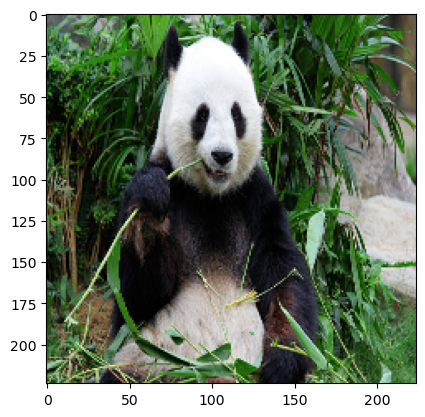

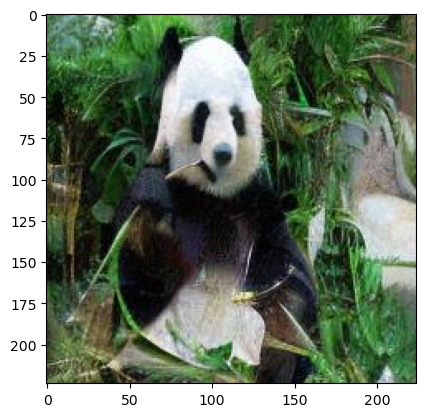

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.30585 | Logit Diff: 1.82332
Label: 264 | Logit Before: 3.17343 | Logit After: 1.98101 | Logit Diff: -1.19242
Label: 428 | Logit Before: 4.07258 | Logit After: 3.44175 | Logit Diff: -0.63083
Label: 190 | Logit Before: 1.40211 | Logit After: 5.64424 | Logit Diff: 4.24213
Average Logit Difference: 1.06055
Positive Percentage: 50.00%
Verification Status: Verified
True
1.0605487823486328
Processing image: epsilon_2.jpg
2
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 91.30it/s]


Finished attacking: epsilon_2.jpg


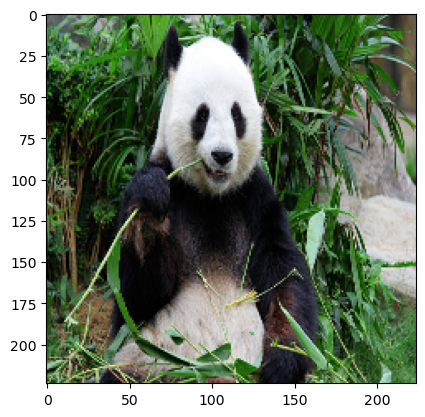

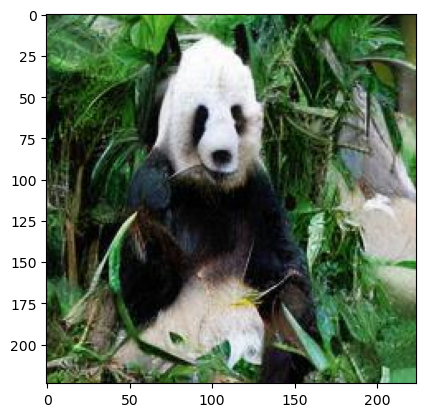

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -0.56379 | Logit Diff: 2.56538
Label: 264 | Logit Before: 3.17343 | Logit After: 2.93036 | Logit Diff: -0.24307
Label: 428 | Logit Before: 4.07258 | Logit After: 3.46674 | Logit Diff: -0.60583
Label: 190 | Logit Before: 1.40211 | Logit After: 4.58473 | Logit Diff: 3.18262
Average Logit Difference: 1.22478
Positive Percentage: 50.00%
Verification Status: Verified
True
1.2247750163078308
Processing image: epsilon_5.jpg
5
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 78.33it/s]


Finished attacking: epsilon_5.jpg


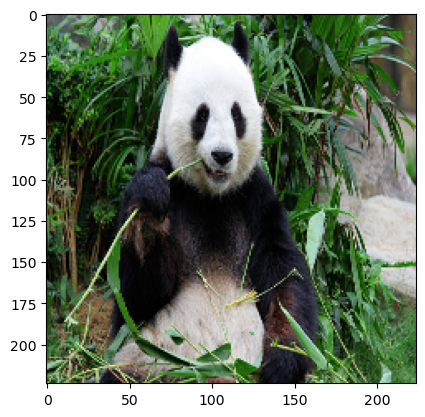

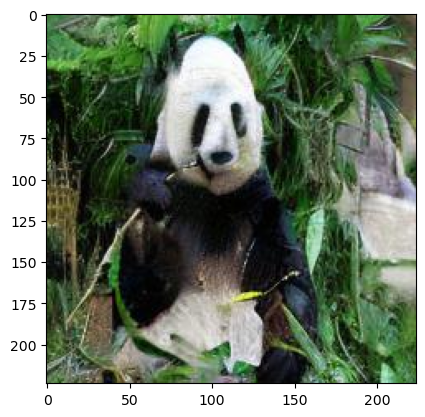

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.82643 | Logit Diff: 0.30274
Label: 264 | Logit Before: 3.17343 | Logit After: 1.50972 | Logit Diff: -1.66372
Label: 428 | Logit Before: 4.07258 | Logit After: 3.30797 | Logit Diff: -0.76461
Label: 190 | Logit Before: 1.40211 | Logit After: 2.38293 | Logit Diff: 0.98082
Average Logit Difference: -0.28619
Positive Percentage: 50.00%
Verification Status: Verified
True
-0.2861901819705963
Processing image: epsilon_31.jpg
31
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 86.58it/s]


Finished attacking: epsilon_31.jpg


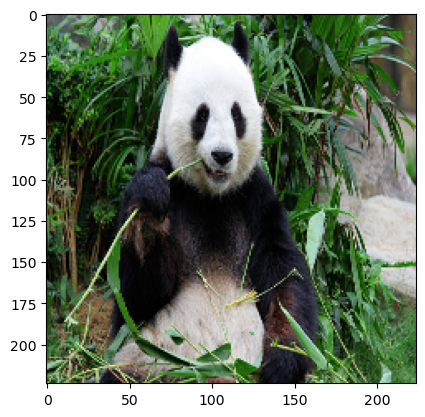

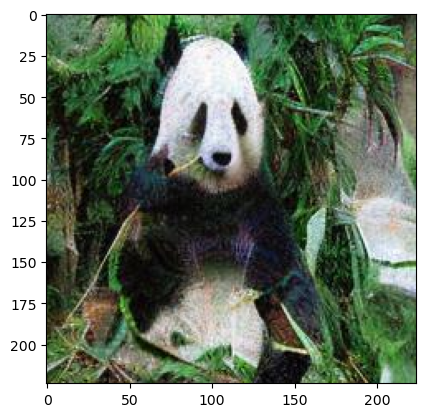

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.04354 | Logit Diff: 2.08563
Label: 264 | Logit Before: 3.17343 | Logit After: 0.75485 | Logit Diff: -2.41859
Label: 428 | Logit Before: 4.07258 | Logit After: 3.43767 | Logit Diff: -0.63491
Label: 190 | Logit Before: 1.40211 | Logit After: 2.94746 | Logit Diff: 1.54535
Average Logit Difference: 0.14437
Positive Percentage: 50.00%
Verification Status: Verified
True
0.14437133073806763
Processing image: epsilon_36.jpg
36
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 95.47it/s]


Finished attacking: epsilon_36.jpg


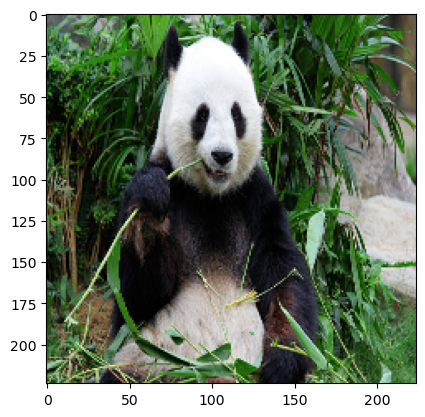

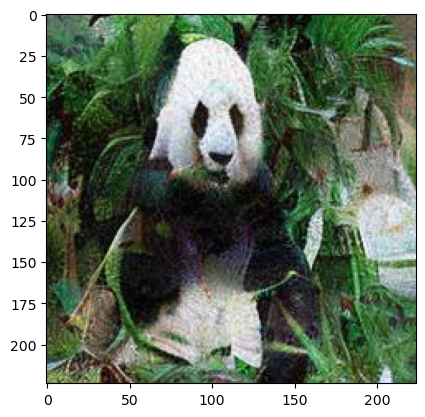

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.07418 | Logit Diff: 1.05499
Label: 264 | Logit Before: 3.17343 | Logit After: 2.30175 | Logit Diff: -0.87169
Label: 428 | Logit Before: 4.07258 | Logit After: 4.30063 | Logit Diff: 0.22806
Label: 190 | Logit Before: 1.40211 | Logit After: 2.84559 | Logit Diff: 1.44348
Average Logit Difference: 0.46371
Positive Percentage: 75.00%
Verification Status: Verified
True
0.4637097716331482
Processing image: epsilon_38.jpg
38
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 81.70it/s]


Finished attacking: epsilon_38.jpg


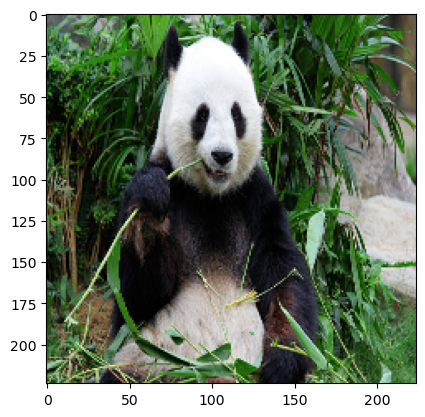

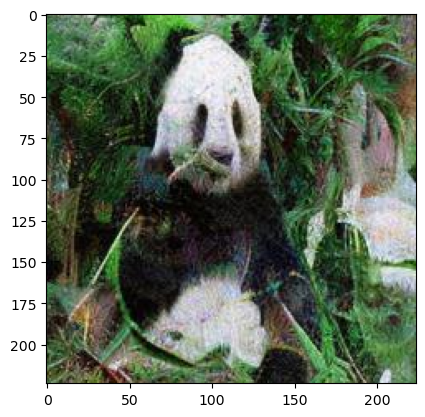

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.98571 | Logit Diff: 0.14346
Label: 264 | Logit Before: 3.17343 | Logit After: 2.01292 | Logit Diff: -1.16052
Label: 428 | Logit Before: 4.07258 | Logit After: 2.36926 | Logit Diff: -1.70332
Label: 190 | Logit Before: 1.40211 | Logit After: 3.48533 | Logit Diff: 2.08322
Average Logit Difference: -0.15929
Positive Percentage: 50.00%
Verification Status: Verified
True
-0.1592903733253479
Processing image: epsilon_13.jpg
13
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 86.12it/s]


Finished attacking: epsilon_13.jpg


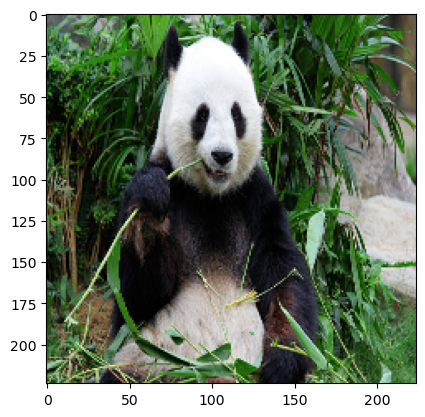

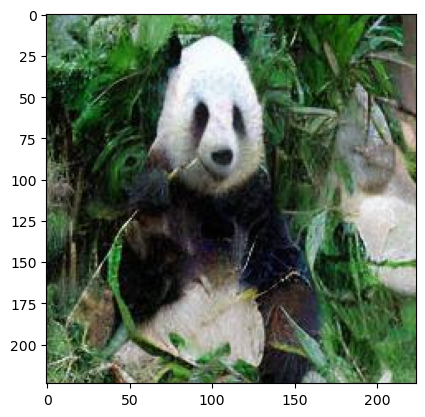

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.55039 | Logit Diff: 1.57878
Label: 264 | Logit Before: 3.17343 | Logit After: 3.01369 | Logit Diff: -0.15975
Label: 428 | Logit Before: 4.07258 | Logit After: 3.65915 | Logit Diff: -0.41343
Label: 190 | Logit Before: 1.40211 | Logit After: 4.37902 | Logit Diff: 2.97691
Average Logit Difference: 0.99563
Positive Percentage: 50.00%
Verification Status: Verified
True
0.9956289231777191
Processing image: epsilon_14.jpg
14
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 89.29it/s]


Finished attacking: epsilon_14.jpg


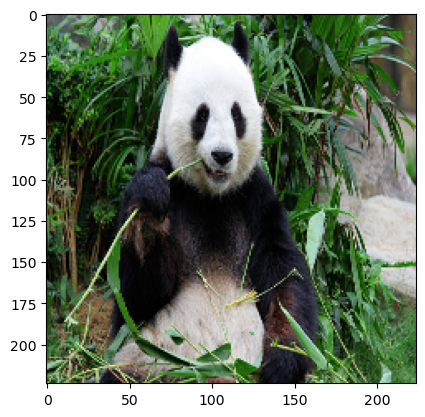

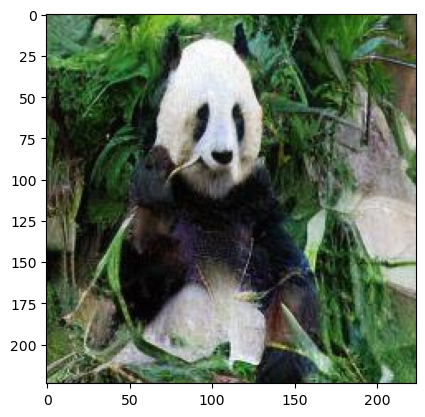

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.60772 | Logit Diff: 1.52145
Label: 264 | Logit Before: 3.17343 | Logit After: 2.45403 | Logit Diff: -0.71941
Label: 428 | Logit Before: 4.07258 | Logit After: 3.08061 | Logit Diff: -0.99197
Label: 190 | Logit Before: 1.40211 | Logit After: 4.46620 | Logit Diff: 3.06409
Average Logit Difference: 0.71854
Positive Percentage: 50.00%
Verification Status: Verified
True
0.7185394763946533
Processing image: epsilon_21.jpg
21
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 95.08it/s]


Finished attacking: epsilon_21.jpg


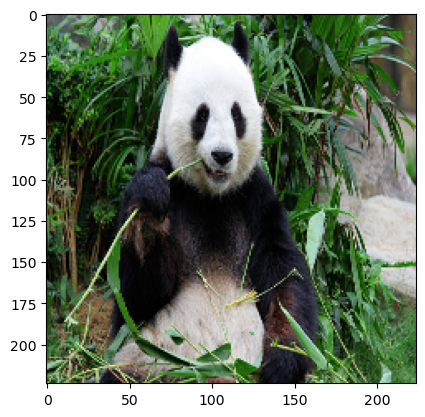

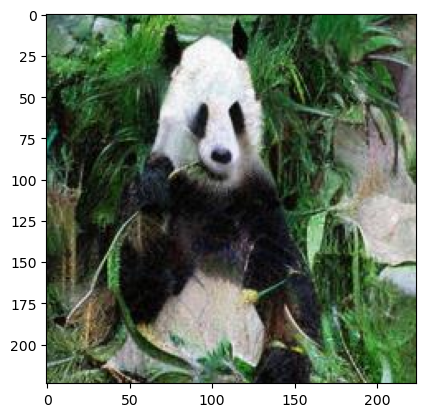

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.23306 | Logit Diff: 0.89611
Label: 264 | Logit Before: 3.17343 | Logit After: 3.29360 | Logit Diff: 0.12017
Label: 428 | Logit Before: 4.07258 | Logit After: 3.29487 | Logit Diff: -0.77771
Label: 190 | Logit Before: 1.40211 | Logit After: 3.06631 | Logit Diff: 1.66420
Average Logit Difference: 0.47569
Positive Percentage: 75.00%
Verification Status: Verified
True
0.47569161653518677
Processing image: epsilon_26.jpg
26
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 96.53it/s]


Finished attacking: epsilon_26.jpg


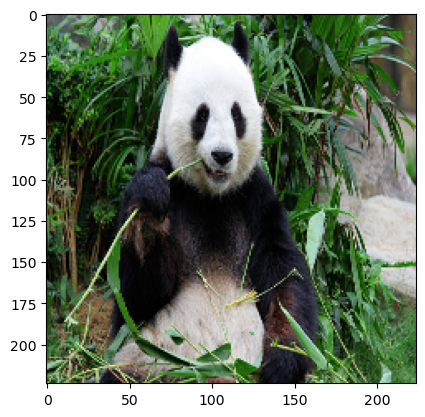

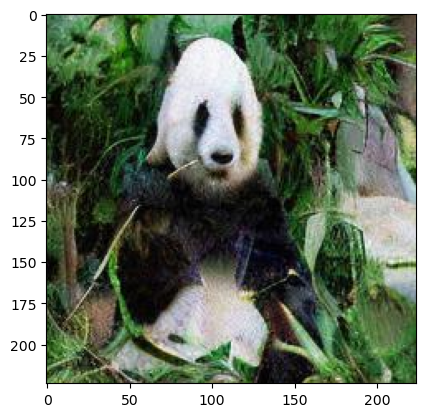

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.57119 | Logit Diff: 1.55798
Label: 264 | Logit Before: 3.17343 | Logit After: 2.81901 | Logit Diff: -0.35443
Label: 428 | Logit Before: 4.07258 | Logit After: 3.22379 | Logit Diff: -0.84878
Label: 190 | Logit Before: 1.40211 | Logit After: 3.19134 | Logit Diff: 1.78923
Average Logit Difference: 0.53600
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5359989404678345
Processing image: epsilon_28.jpg
28
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 86.04it/s]


Finished attacking: epsilon_28.jpg


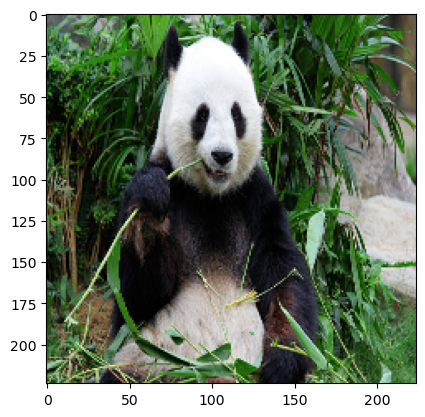

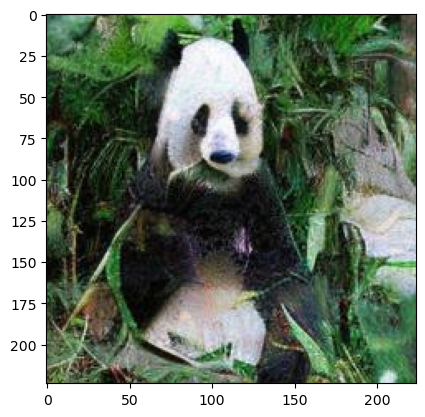

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.63480 | Logit Diff: 0.49437
Label: 264 | Logit Before: 3.17343 | Logit After: 2.68912 | Logit Diff: -0.48431
Label: 428 | Logit Before: 4.07258 | Logit After: 3.33892 | Logit Diff: -0.73366
Label: 190 | Logit Before: 1.40211 | Logit After: 3.05962 | Logit Diff: 1.65751
Average Logit Difference: 0.23348
Positive Percentage: 50.00%
Verification Status: Verified
True
0.23347783088684082
Processing image: epsilon_39.jpg
39
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 82.20it/s]


Finished attacking: epsilon_39.jpg


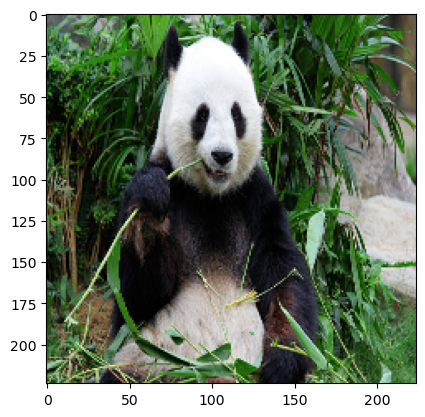

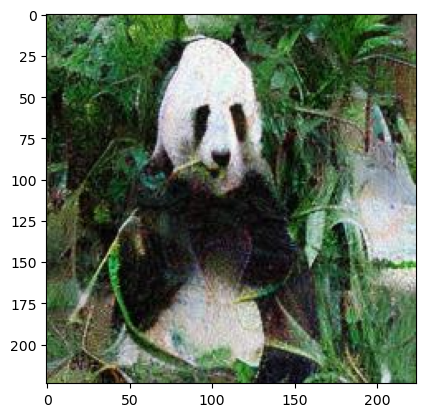

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.56514 | Logit Diff: 0.56403
Label: 264 | Logit Before: 3.17343 | Logit After: 1.54964 | Logit Diff: -1.62379
Label: 428 | Logit Before: 4.07258 | Logit After: 4.23540 | Logit Diff: 0.16282
Label: 190 | Logit Before: 1.40211 | Logit After: 5.44031 | Logit Diff: 4.03820
Average Logit Difference: 0.78531
Positive Percentage: 75.00%
Verification Status: Verified
True
0.7853123545646667
Processing image: epsilon_37.jpg
37
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 93.87it/s]


Finished attacking: epsilon_37.jpg


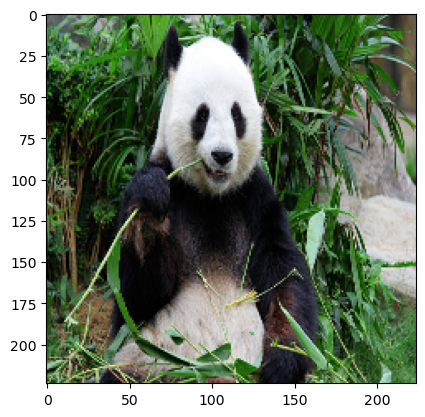

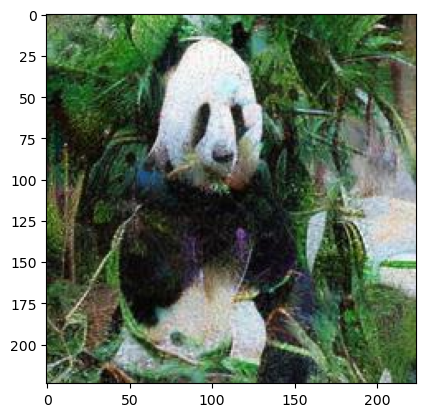

1/1 [==============================] - 0s 31ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.54694 | Logit Diff: -0.41777
Label: 264 | Logit Before: 3.17343 | Logit After: 3.30428 | Logit Diff: 0.13085
Label: 428 | Logit Before: 4.07258 | Logit After: 3.39962 | Logit Diff: -0.67296
Label: 190 | Logit Before: 1.40211 | Logit After: 3.82640 | Logit Diff: 2.42429
Average Logit Difference: 0.36610
Positive Percentage: 50.00%
Verification Status: Verified
True
0.3661017417907715
Processing image: epsilon_30.jpg
30
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 92.36it/s]


Finished attacking: epsilon_30.jpg


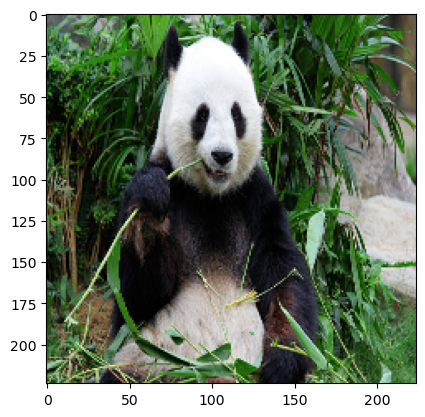

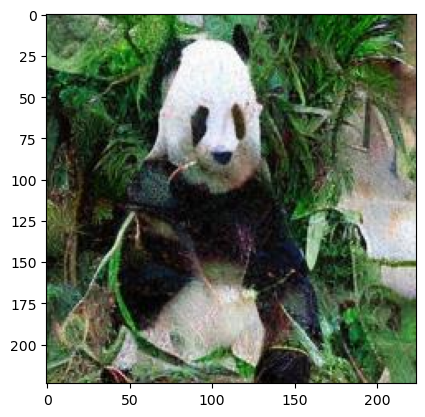

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.57270 | Logit Diff: 0.55647
Label: 264 | Logit Before: 3.17343 | Logit After: 3.34630 | Logit Diff: 0.17287
Label: 428 | Logit Before: 4.07258 | Logit After: 3.34756 | Logit Diff: -0.72501
Label: 190 | Logit Before: 1.40211 | Logit After: 4.22113 | Logit Diff: 2.81901
Average Logit Difference: 0.70584
Positive Percentage: 75.00%
Verification Status: Verified
True
0.7058353424072266
Processing image: epsilon_4.jpg
4
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 93.87it/s]


Finished attacking: epsilon_4.jpg


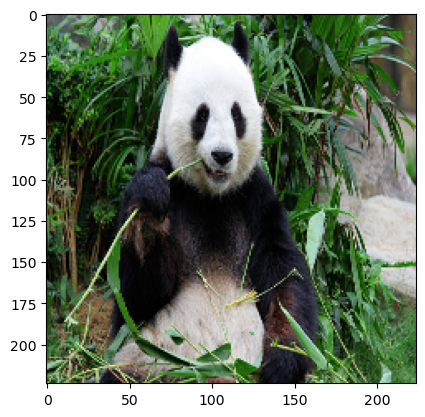

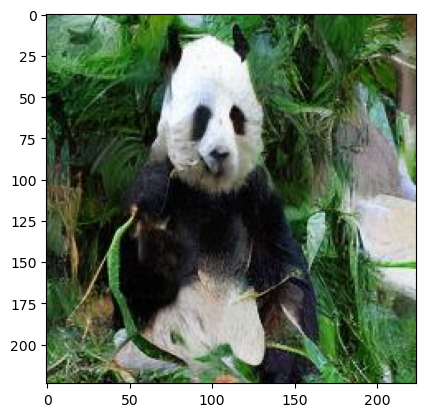

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.53444 | Logit Diff: 1.59473
Label: 264 | Logit Before: 3.17343 | Logit After: 4.52425 | Logit Diff: 1.35082
Label: 428 | Logit Before: 4.07258 | Logit After: 3.92808 | Logit Diff: -0.14450
Label: 190 | Logit Before: 1.40211 | Logit After: 4.39563 | Logit Diff: 2.99352
Average Logit Difference: 1.44864
Positive Percentage: 75.00%
Verification Status: Verified
True
1.4486426413059235
Processing image: epsilon_3.jpg
3
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 92.24it/s]


Finished attacking: epsilon_3.jpg


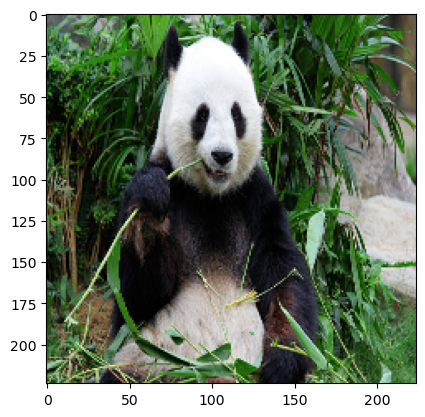

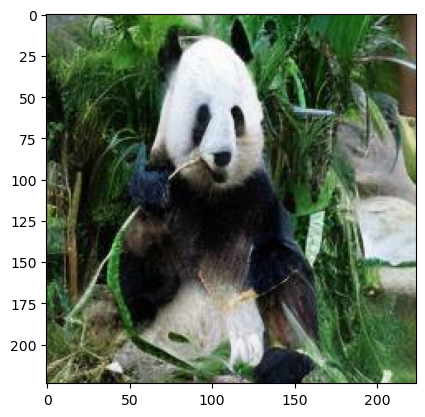

1/1 [==============================] - 0s 31ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -0.73806 | Logit Diff: 2.39111
Label: 264 | Logit Before: 3.17343 | Logit After: 3.36154 | Logit Diff: 0.18810
Label: 428 | Logit Before: 4.07258 | Logit After: 3.43487 | Logit Diff: -0.63771
Label: 190 | Logit Before: 1.40211 | Logit After: 4.03882 | Logit Diff: 2.63671
Average Logit Difference: 1.14455
Positive Percentage: 75.00%
Verification Status: Verified
True
1.1445521116256714
Processing image: epsilon_33.jpg
33
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 94.78it/s]


Finished attacking: epsilon_33.jpg


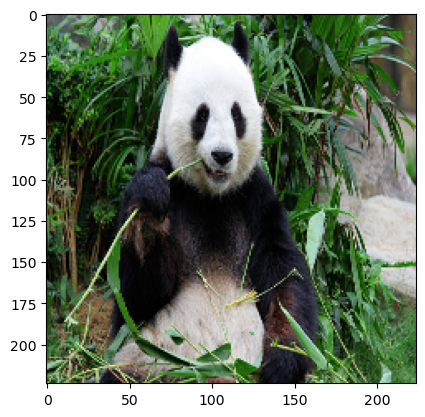

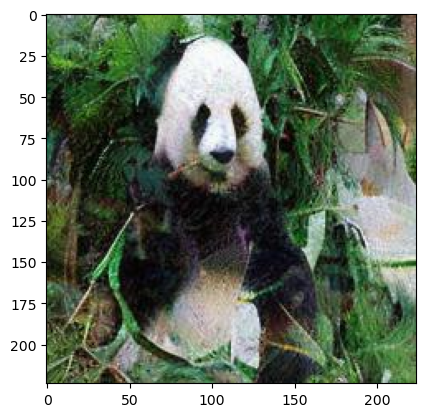

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.22704 | Logit Diff: 0.90213
Label: 264 | Logit Before: 3.17343 | Logit After: 2.29836 | Logit Diff: -0.87507
Label: 428 | Logit Before: 4.07258 | Logit After: 3.78989 | Logit Diff: -0.28269
Label: 190 | Logit Before: 1.40211 | Logit After: 4.41228 | Logit Diff: 3.01017
Average Logit Difference: 0.68864
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6886351704597473
Processing image: epsilon_34.jpg
34
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 97.01it/s]


Finished attacking: epsilon_34.jpg


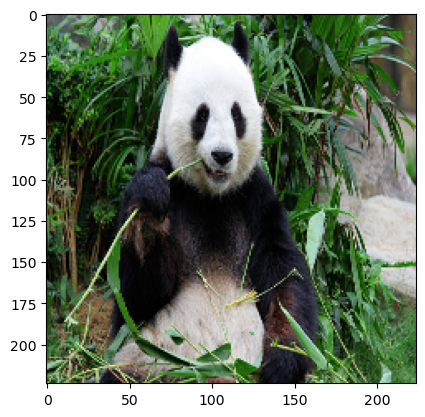

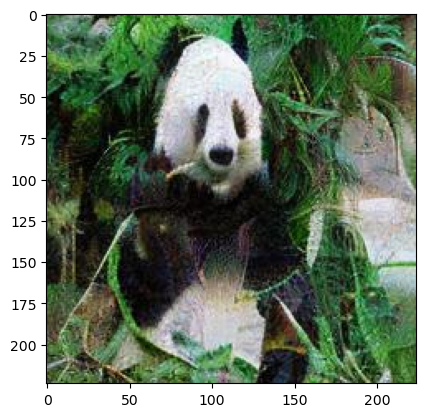

1/1 [==============================] - 0s 31ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.57487 | Logit Diff: 0.55430
Label: 264 | Logit Before: 3.17343 | Logit After: 3.51283 | Logit Diff: 0.33940
Label: 428 | Logit Before: 4.07258 | Logit After: 3.40711 | Logit Diff: -0.66547
Label: 190 | Logit Before: 1.40211 | Logit After: 5.86128 | Logit Diff: 4.45917
Average Logit Difference: 1.17185
Positive Percentage: 75.00%
Verification Status: Verified
True
1.1718499660491943
Processing image: epsilon_7.jpg
7
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 89.03it/s]


Finished attacking: epsilon_7.jpg


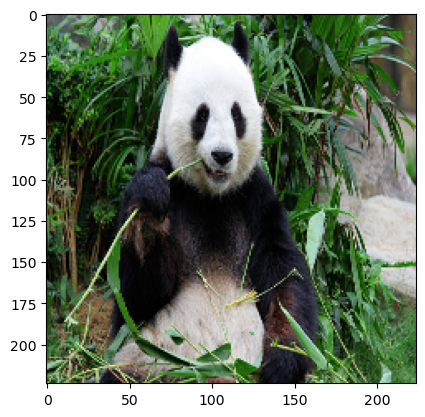

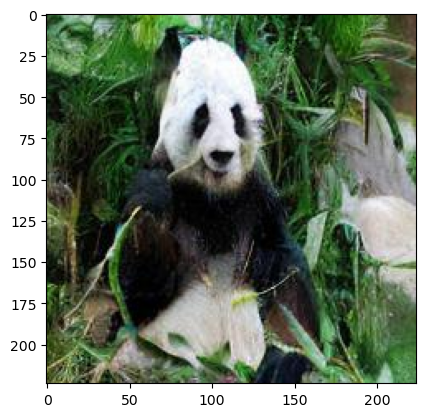

1/1 [==============================] - 0s 31ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.57108 | Logit Diff: 1.55808
Label: 264 | Logit Before: 3.17343 | Logit After: 2.60853 | Logit Diff: -0.56490
Label: 428 | Logit Before: 4.07258 | Logit After: 2.95274 | Logit Diff: -1.11984
Label: 190 | Logit Before: 1.40211 | Logit After: 5.21079 | Logit Diff: 3.80868
Average Logit Difference: 0.92051
Positive Percentage: 50.00%
Verification Status: Verified
True
0.9205054342746735
Processing image: epsilon_9.jpg
9
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 89.25it/s]


Finished attacking: epsilon_9.jpg


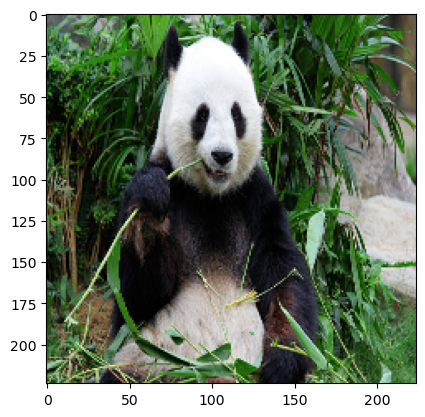

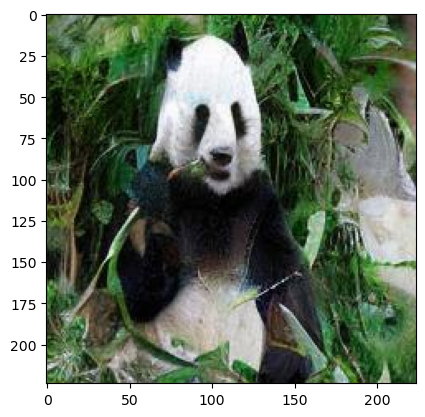

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.90419 | Logit Diff: 1.22498
Label: 264 | Logit Before: 3.17343 | Logit After: 1.75749 | Logit Diff: -1.41594
Label: 428 | Logit Before: 4.07258 | Logit After: 2.87329 | Logit Diff: -1.19929
Label: 190 | Logit Before: 1.40211 | Logit After: 3.42220 | Logit Diff: 2.02009
Average Logit Difference: 0.15746
Positive Percentage: 50.00%
Verification Status: Verified
True
0.1574597954750061
Processing image: epsilon_19.jpg
19
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 82.76it/s]


Finished attacking: epsilon_19.jpg


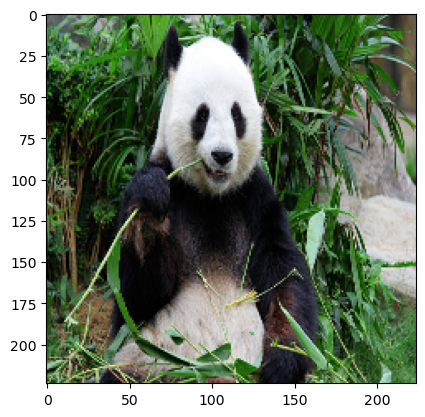

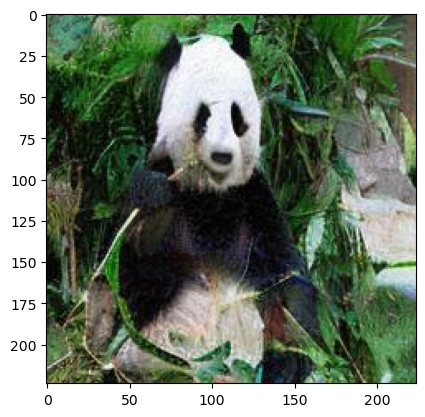

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.95594 | Logit Diff: 1.17323
Label: 264 | Logit Before: 3.17343 | Logit After: 1.64880 | Logit Diff: -1.52463
Label: 428 | Logit Before: 4.07258 | Logit After: 3.93245 | Logit Diff: -0.14013
Label: 190 | Logit Before: 1.40211 | Logit After: 4.23153 | Logit Diff: 2.82942
Average Logit Difference: 0.58447
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5844717919826508
Processing image: epsilon_17.jpg
17
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 86.02it/s]


Finished attacking: epsilon_17.jpg


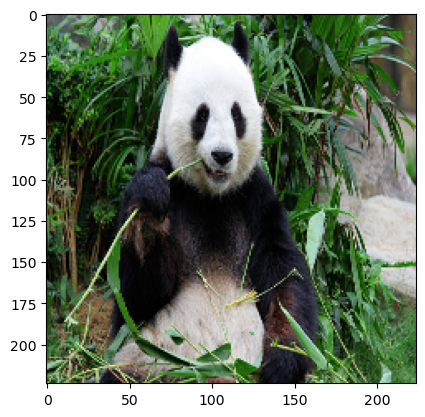

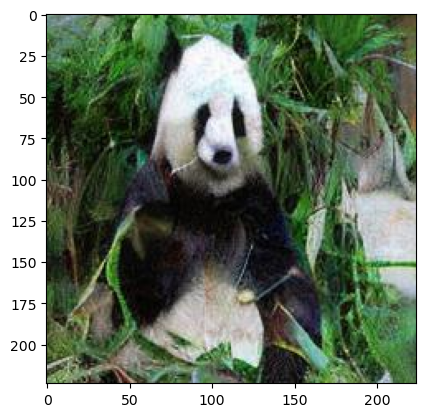

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.42261 | Logit Diff: 0.70656
Label: 264 | Logit Before: 3.17343 | Logit After: 1.92860 | Logit Diff: -1.24483
Label: 428 | Logit Before: 4.07258 | Logit After: 3.67887 | Logit Diff: -0.39371
Label: 190 | Logit Before: 1.40211 | Logit After: 3.75766 | Logit Diff: 2.35555
Average Logit Difference: 0.35589
Positive Percentage: 50.00%
Verification Status: Verified
True
0.35589417815208435
Processing image: epsilon_10.jpg
10
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 86.63it/s]


Finished attacking: epsilon_10.jpg


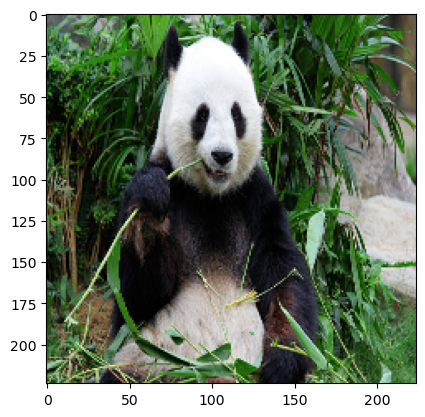

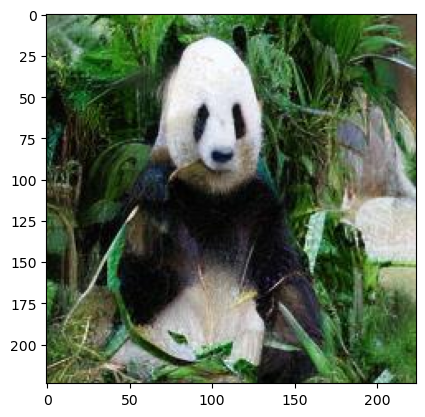

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.31138 | Logit Diff: 1.81779
Label: 264 | Logit Before: 3.17343 | Logit After: 2.38041 | Logit Diff: -0.79302
Label: 428 | Logit Before: 4.07258 | Logit After: 3.48452 | Logit Diff: -0.58805
Label: 190 | Logit Before: 1.40211 | Logit After: 3.35592 | Logit Diff: 1.95381
Average Logit Difference: 0.59763
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5976301729679108
Processing image: epsilon_25.jpg
25
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 93.16it/s]


Finished attacking: epsilon_25.jpg


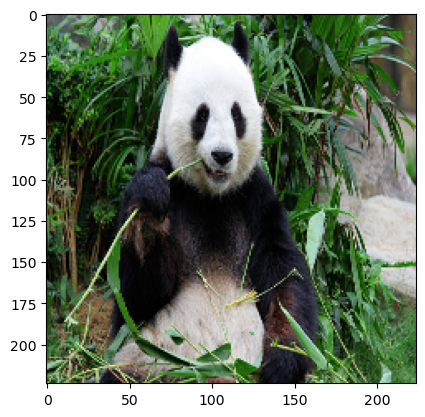

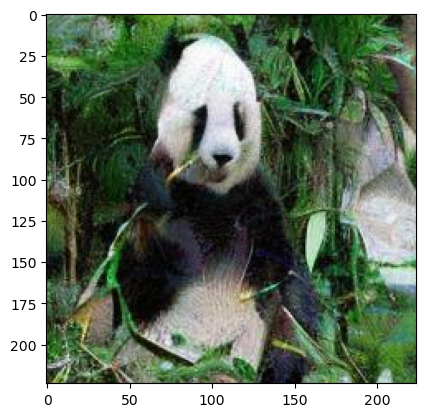

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.74978 | Logit Diff: 1.37938
Label: 264 | Logit Before: 3.17343 | Logit After: 3.60620 | Logit Diff: 0.43277
Label: 428 | Logit Before: 4.07258 | Logit After: 3.69506 | Logit Diff: -0.37752
Label: 190 | Logit Before: 1.40211 | Logit After: 3.46054 | Logit Diff: 2.05843
Average Logit Difference: 0.87327
Positive Percentage: 75.00%
Verification Status: Verified
True
0.8732657134532928
Processing image: epsilon_22.jpg
22
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 92.47it/s]


Finished attacking: epsilon_22.jpg


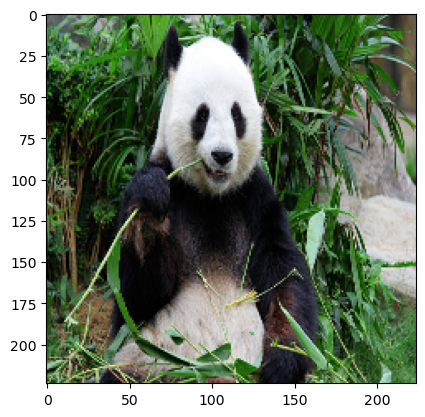

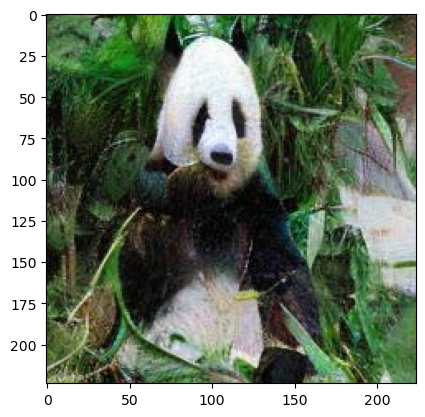

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.81652 | Logit Diff: 0.31265
Label: 264 | Logit Before: 3.17343 | Logit After: 1.07259 | Logit Diff: -2.10084
Label: 428 | Logit Before: 4.07258 | Logit After: 3.65939 | Logit Diff: -0.41319
Label: 190 | Logit Before: 1.40211 | Logit After: 2.61121 | Logit Diff: 1.20910
Average Logit Difference: -0.24807
Positive Percentage: 50.00%
Verification Status: Verified
True
-0.24807071685791016
Processing image: epsilon_8.jpg
8
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 88.53it/s]


Finished attacking: epsilon_8.jpg


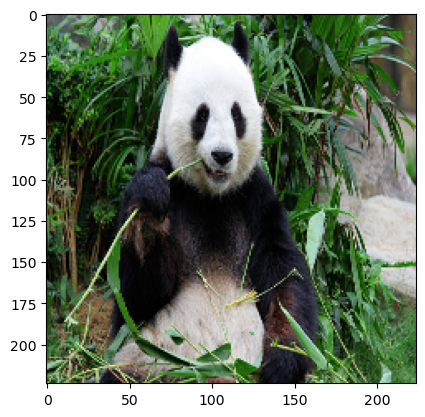

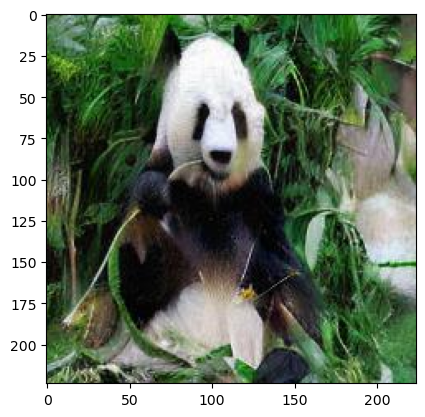

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.66786 | Logit Diff: 1.46131
Label: 264 | Logit Before: 3.17343 | Logit After: 2.48632 | Logit Diff: -0.68711
Label: 428 | Logit Before: 4.07258 | Logit After: 4.00961 | Logit Diff: -0.06297
Label: 190 | Logit Before: 1.40211 | Logit After: 3.32098 | Logit Diff: 1.91886
Average Logit Difference: 0.65752
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6575236618518829
Processing image: epsilon_6.jpg
6
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 92.13it/s]


Finished attacking: epsilon_6.jpg


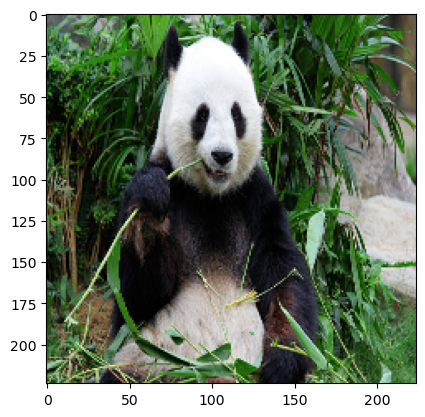

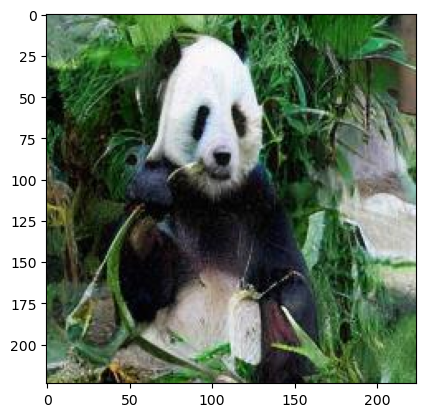

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.58156 | Logit Diff: 1.54761
Label: 264 | Logit Before: 3.17343 | Logit After: 2.21982 | Logit Diff: -0.95361
Label: 428 | Logit Before: 4.07258 | Logit After: 4.28741 | Logit Diff: 0.21483
Label: 190 | Logit Before: 1.40211 | Logit After: 6.40136 | Logit Diff: 4.99925
Average Logit Difference: 1.45202
Positive Percentage: 75.00%
Verification Status: Verified
True
1.452019363641739
Processing image: epsilon_1.jpg
1
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 95.72it/s]


Finished attacking: epsilon_1.jpg


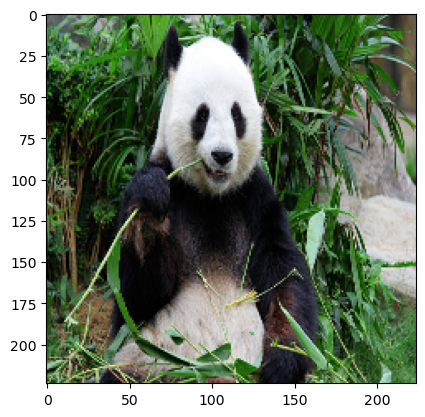

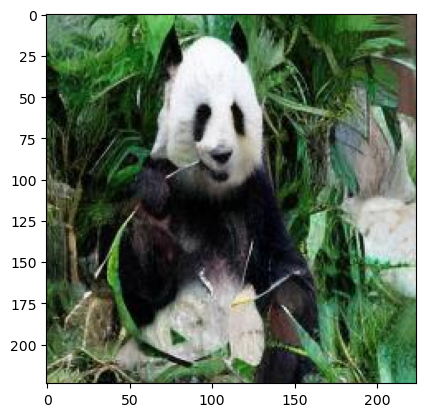

1/1 [==============================] - 0s 39ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.48840 | Logit Diff: 0.64077
Label: 264 | Logit Before: 3.17343 | Logit After: 2.93456 | Logit Diff: -0.23888
Label: 428 | Logit Before: 4.07258 | Logit After: 3.11382 | Logit Diff: -0.95876
Label: 190 | Logit Before: 1.40211 | Logit After: 3.16132 | Logit Diff: 1.75921
Average Logit Difference: 0.30059
Positive Percentage: 50.00%
Verification Status: Verified
True
0.30058640241622925
Processing image: epsilon_35.jpg
35
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 84.18it/s]


Finished attacking: epsilon_35.jpg


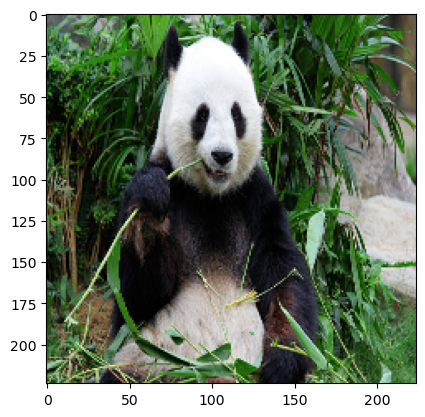

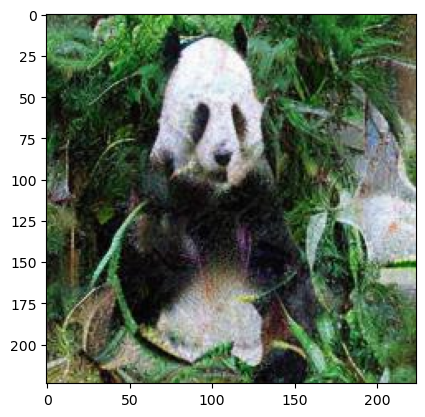

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.40216 | Logit Diff: -0.27299
Label: 264 | Logit Before: 3.17343 | Logit After: 2.95292 | Logit Diff: -0.22051
Label: 428 | Logit Before: 4.07258 | Logit After: 3.16249 | Logit Diff: -0.91009
Label: 190 | Logit Before: 1.40211 | Logit After: 7.80887 | Logit Diff: 6.40676
Average Logit Difference: 1.25079
Positive Percentage: 25.00%
Verification Status: Not Verified
False
1.2507922053337097
Processing image: epsilon_32.jpg
32
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 89.52it/s]


Finished attacking: epsilon_32.jpg


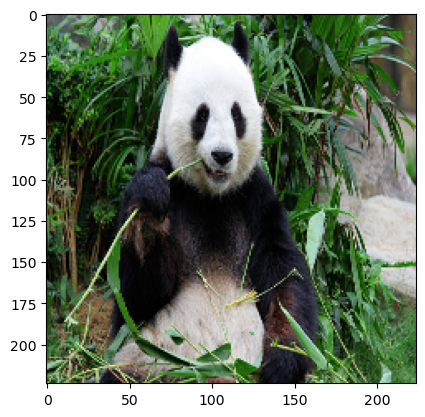

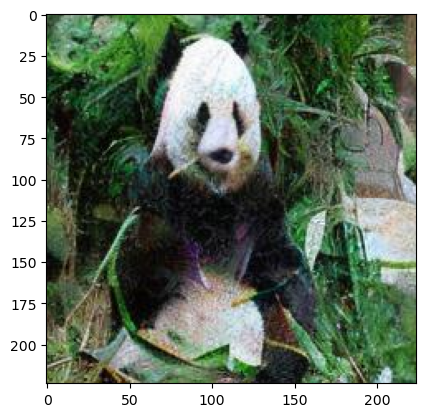

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.68852 | Logit Diff: 1.44065
Label: 264 | Logit Before: 3.17343 | Logit After: 1.44796 | Logit Diff: -1.72547
Label: 428 | Logit Before: 4.07258 | Logit After: 3.58965 | Logit Diff: -0.48293
Label: 190 | Logit Before: 1.40211 | Logit After: 4.33910 | Logit Diff: 2.93698
Average Logit Difference: 0.54231
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5423067212104797
Processing image: epsilon_40.jpg
40
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 80.95it/s]


Finished attacking: epsilon_40.jpg


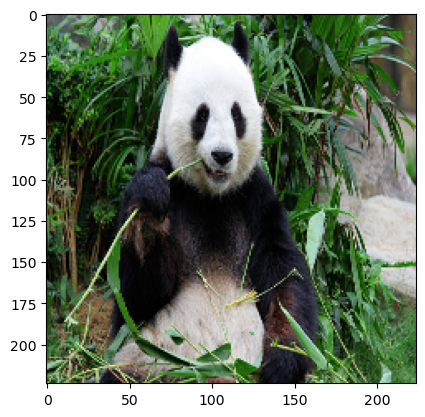

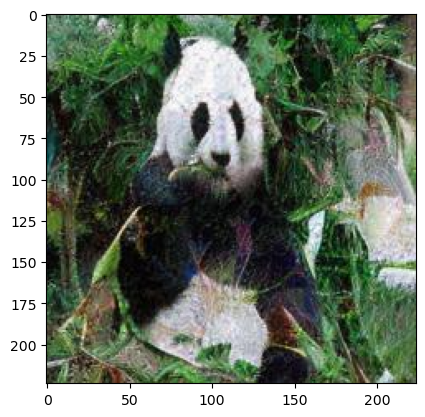

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.92050 | Logit Diff: 1.20867
Label: 264 | Logit Before: 3.17343 | Logit After: 2.90431 | Logit Diff: -0.26913
Label: 428 | Logit Before: 4.07258 | Logit After: 3.20733 | Logit Diff: -0.86525
Label: 190 | Logit Before: 1.40211 | Logit After: 7.35567 | Logit Diff: 5.95356
Average Logit Difference: 1.50696
Positive Percentage: 50.00%
Verification Status: Verified
True
1.5069634914398193
Processing image: epsilon_23.jpg
23
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 97.49it/s]


Finished attacking: epsilon_23.jpg


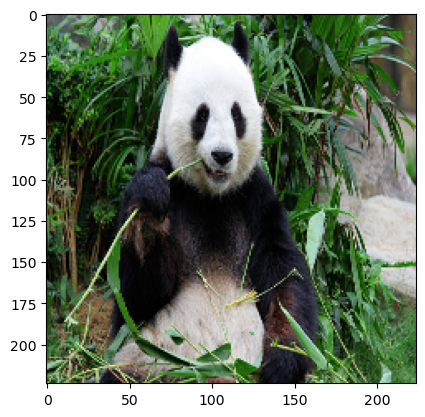

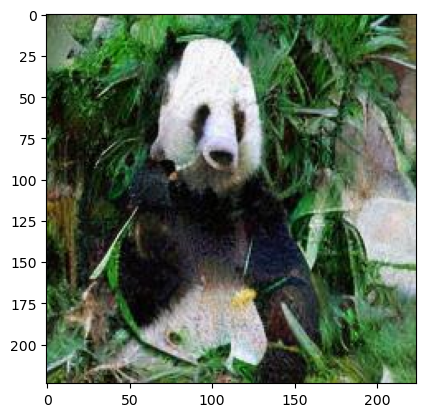

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.01368 | Logit Diff: 1.11549
Label: 264 | Logit Before: 3.17343 | Logit After: 2.77220 | Logit Diff: -0.40123
Label: 428 | Logit Before: 4.07258 | Logit After: 4.06988 | Logit Diff: -0.00269
Label: 190 | Logit Before: 1.40211 | Logit After: 3.29981 | Logit Diff: 1.89770
Average Logit Difference: 0.65232
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6523160934448242
Processing image: epsilon_24.jpg
24
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 37.15it/s]


Finished attacking: epsilon_24.jpg


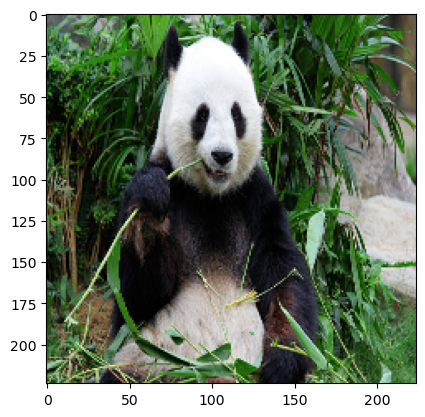

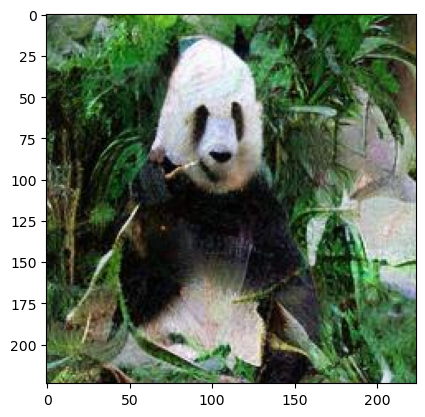

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.49215 | Logit Diff: 0.63702
Label: 264 | Logit Before: 3.17343 | Logit After: 2.30412 | Logit Diff: -0.86931
Label: 428 | Logit Before: 4.07258 | Logit After: 3.97540 | Logit Diff: -0.09718
Label: 190 | Logit Before: 1.40211 | Logit After: 3.51514 | Logit Diff: 2.11303
Average Logit Difference: 0.44589
Positive Percentage: 50.00%
Verification Status: Verified
True
0.44589048624038696
Processing image: epsilon_11.jpg
11
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 28.19it/s]


Finished attacking: epsilon_11.jpg


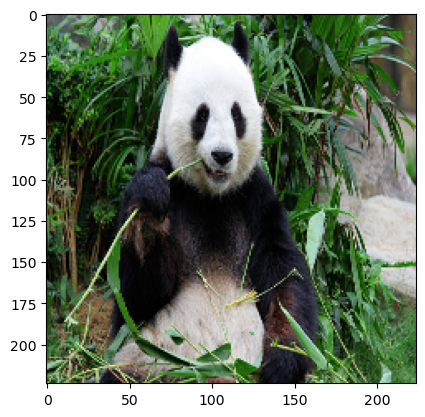

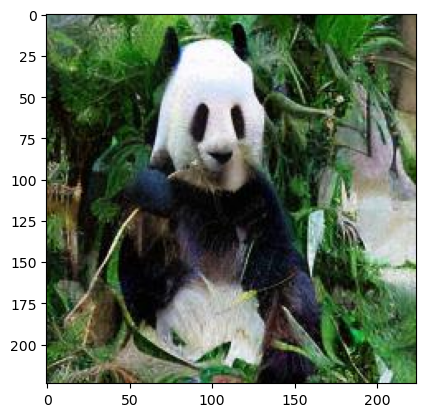

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.74810 | Logit Diff: 1.38107
Label: 264 | Logit Before: 3.17343 | Logit After: 4.82154 | Logit Diff: 1.64811
Label: 428 | Logit Before: 4.07258 | Logit After: 3.89486 | Logit Diff: -0.17772
Label: 190 | Logit Before: 1.40211 | Logit After: 4.62080 | Logit Diff: 3.21869
Average Logit Difference: 1.51754
Positive Percentage: 75.00%
Verification Status: Verified
True
1.5175381004810333
Processing image: epsilon_16.jpg
16
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 92.39it/s]


Finished attacking: epsilon_16.jpg


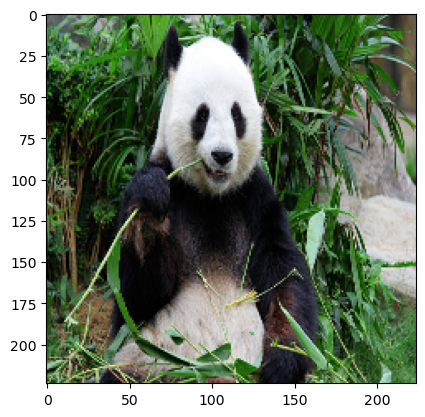

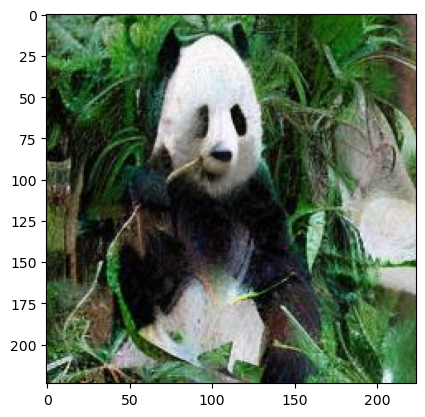

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.74348 | Logit Diff: 1.38569
Label: 264 | Logit Before: 3.17343 | Logit After: 1.42604 | Logit Diff: -1.74740
Label: 428 | Logit Before: 4.07258 | Logit After: 2.44284 | Logit Diff: -1.62974
Label: 190 | Logit Before: 1.40211 | Logit After: 3.51734 | Logit Diff: 2.11523
Average Logit Difference: 0.03095
Positive Percentage: 50.00%
Verification Status: Verified
True
0.030947238206863403
Processing image: epsilon_18.jpg
18
**************************************************
Attacking PGD BlackBox Watermark with diff_attacker_60


1it [00:00, 94.39it/s]


Finished attacking: epsilon_18.jpg


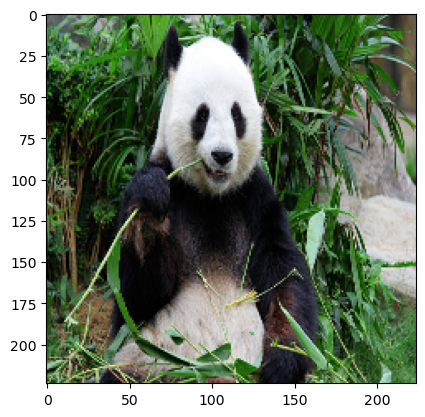

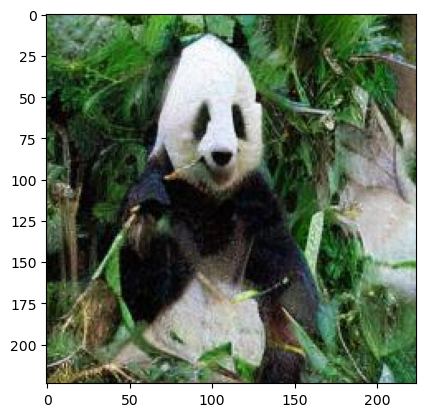

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.29637 | Logit Diff: 1.83280
Label: 264 | Logit Before: 3.17343 | Logit After: 2.00404 | Logit Diff: -1.16940
Label: 428 | Logit Before: 4.07258 | Logit After: 2.94692 | Logit Diff: -1.12566
Label: 190 | Logit Before: 1.40211 | Logit After: 3.36338 | Logit Diff: 1.96127
Average Logit Difference: 0.37475
Positive Percentage: 50.00%
Verification Status: Verified
True
0.37475326657295227


In [21]:
logit_diffs_dic = {}
# Directory where the images are stored
image_dir = "../output/blackbox_epsilon_testing"

# Get a list of all images in the directory
image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]  # Modify for other extensions if needed

# Make sure there are images to process
if not image_files:
    print("No images found in the directory.")
else:
    # Iterate over each image file
    
    for image_file in os.listdir(image_dir):
        # Construct the full image path
        image_path = os.path.join(image_dir, image_file)
        
        print(f"Processing image: {image_file}")

        watermarked_img_path = image_path
        index = image_file.index(".")
        print(image_file[8:index])
        attacked_img_path = f"../output/black_box_attacked_images/perturbed_panda_attacked{image_file[8:index]}.jpg"
        
        
        image = Image.open(watermarked_img_path).convert("RGB")
        
        attacker_name = "diff_attacker_60"
        attacker = attackers[attacker_name]   # Select the attacker
        
        print('*' * print_width)
        print(f'Attacking PGD BlackBox Watermark with {attacker_name}')
        
        
        # # Move attacker model to CUDA if available
        # device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        # attacker.pipe.to(device)  # Ensure the model is on the right device
        
        # Apply the attack
        attacker.attack([watermarked_img_path], [attacked_img_path])
        
        print(f'Finished attacking: {image_file}')

        original_image_path = "../examples/panda.jpg"
        sample_image_org = show_image(original_image_path)
        preprocessed_image_org = preprocess_image(sample_image_org)
        image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)
        
        sample_image_att = show_image(attacked_img_path)
        preprocessed_image = preprocess_image(sample_image_att)
        image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)
        
        original_logits = resnet50.predict(preprocess_input(image_tensor_org))
        attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

        verif, avg_diff = verify_watermark(original_logits, attacked_logits,
                 [726, 264, 428, 190])
        print(verif)
        print(avg_diff)
        dic_key = int(image_file[8:index])
        logit_diffs_dic[dic_key] = avg_diff
        
      


In [22]:
sorted_logit_diffs_dic = {key: logit_diffs_dic[key] for key in sorted(logit_diffs_dic)}
epsilon_values = np.arange(0, 4/255, 0.1/255)


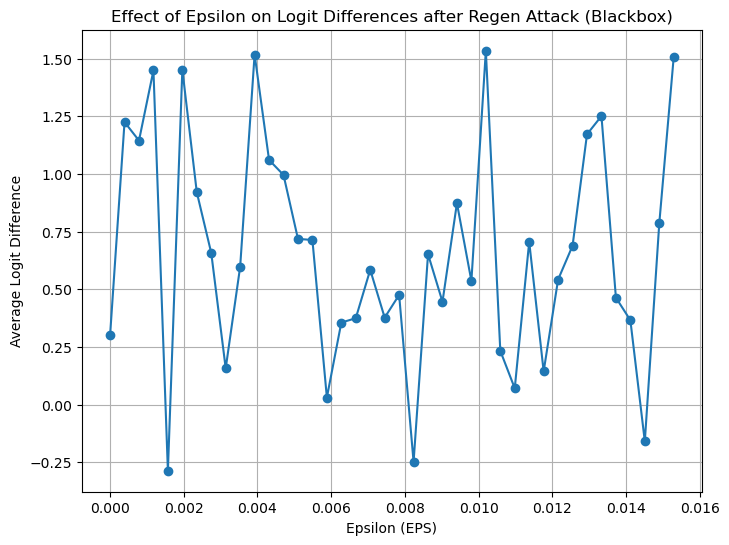

In [24]:
plt.figure(figsize=(8, 6))
plt.plot(epsilon_values, sorted_logit_diffs_dic.values(), marker='o', linestyle='-')
plt.xlabel("Epsilon (EPS)")
plt.ylabel("Average Logit Difference")
plt.title("Effect of Epsilon on Logit Differences after Regen Attack (Blackbox)")
plt.grid(True)
plt.savefig("../output/logit_diff_vs_epsilon.png")

plt.show()

Diffuse attack initialized with noise step 0 and use prompt 0


1it [00:00, 44.48it/s]


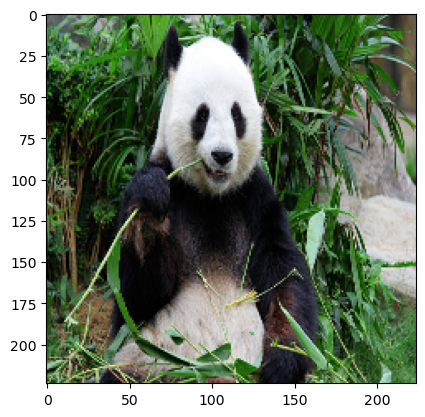

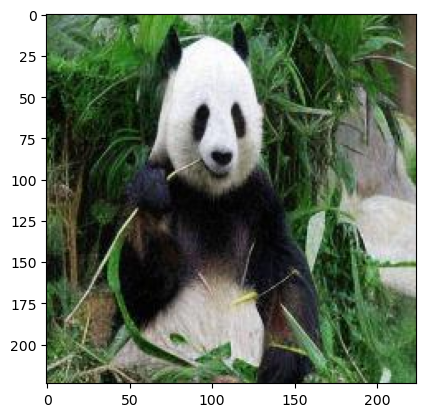

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.15631 | Logit Diff: 1.97286
Label: 264 | Logit Before: 3.17343 | Logit After: 3.16670 | Logit Diff: -0.00673
Label: 428 | Logit Before: 4.07258 | Logit After: 3.32054 | Logit Diff: -0.75203
Label: 190 | Logit Before: 1.40211 | Logit After: 3.78951 | Logit Diff: 2.38740
Average Logit Difference: 0.90037
Positive Percentage: 50.00%
Verification Status: Verified
True 0.9003749191761017
Diffuse attack initialized with noise step 20 and use prompt 0


1it [00:00, 10.16it/s]


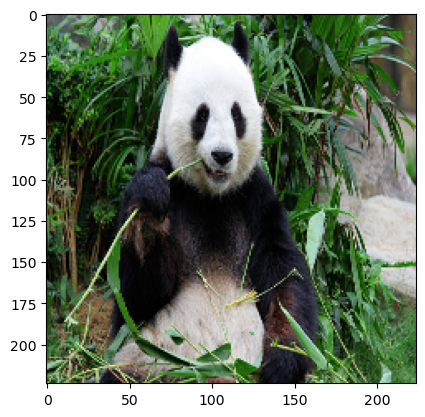

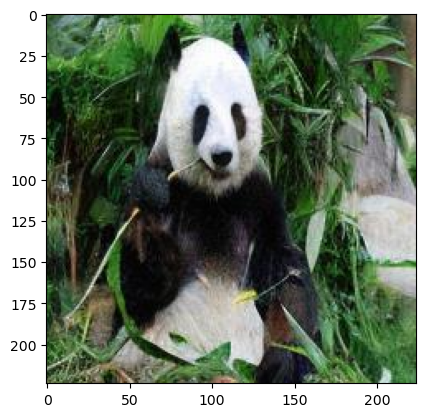

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.61257 | Logit Diff: 1.51660
Label: 264 | Logit Before: 3.17343 | Logit After: 3.79739 | Logit Diff: 0.62396
Label: 428 | Logit Before: 4.07258 | Logit After: 3.26451 | Logit Diff: -0.80807
Label: 190 | Logit Before: 1.40211 | Logit After: 3.94052 | Logit Diff: 2.53841
Average Logit Difference: 0.96773
Positive Percentage: 75.00%
Verification Status: Verified
True 0.9677256345748901
Diffuse attack initialized with noise step 40 and use prompt 0


1it [00:00,  8.99it/s]


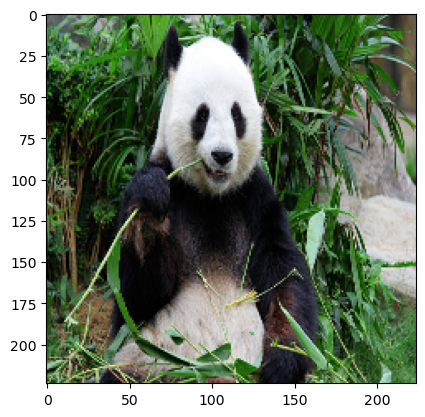

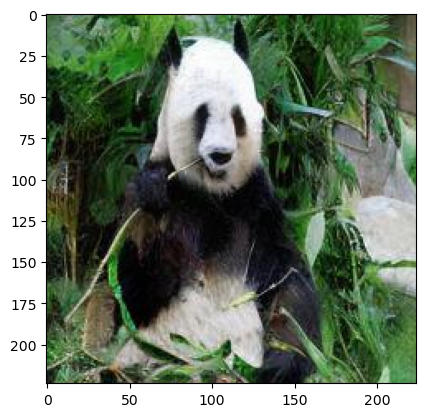

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.81661 | Logit Diff: 1.31256
Label: 264 | Logit Before: 3.17343 | Logit After: 2.99190 | Logit Diff: -0.18153
Label: 428 | Logit Before: 4.07258 | Logit After: 4.42466 | Logit Diff: 0.35209
Label: 190 | Logit Before: 1.40211 | Logit After: 3.24437 | Logit Diff: 1.84226
Average Logit Difference: 0.83134
Positive Percentage: 75.00%
Verification Status: Verified
True 0.8313443958759308
Diffuse attack initialized with noise step 80 and use prompt 0


1it [00:00, 44.65it/s]


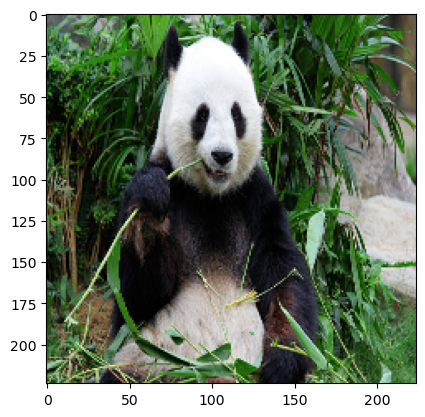

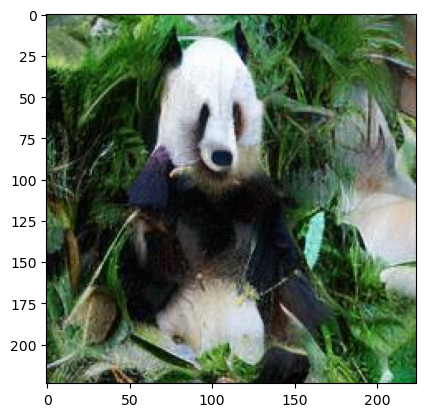

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.47096 | Logit Diff: 0.65821
Label: 264 | Logit Before: 3.17343 | Logit After: 3.24550 | Logit Diff: 0.07206
Label: 428 | Logit Before: 4.07258 | Logit After: 3.19589 | Logit Diff: -0.87668
Label: 190 | Logit Before: 1.40211 | Logit After: 3.25519 | Logit Diff: 1.85308
Average Logit Difference: 0.42667
Positive Percentage: 75.00%
Verification Status: Verified
True 0.42666733264923096
Diffuse attack initialized with noise step 160 and use prompt 0


1it [00:00, 10.48it/s]


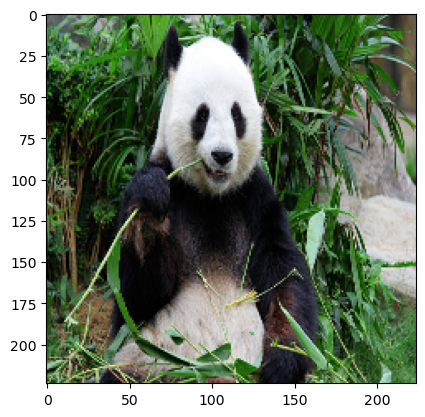

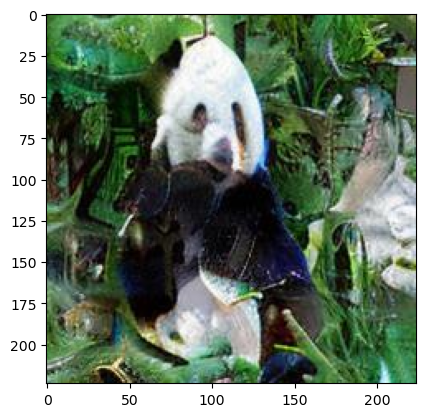

1/1 [==============================] - 0s 32ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.95045 | Logit Diff: 0.17871
Label: 264 | Logit Before: 3.17343 | Logit After: 0.36918 | Logit Diff: -2.80426
Label: 428 | Logit Before: 4.07258 | Logit After: 2.56221 | Logit Diff: -1.51037
Label: 190 | Logit Before: 1.40211 | Logit After: 4.17403 | Logit Diff: 2.77192
Average Logit Difference: -0.34100
Positive Percentage: 50.00%
Verification Status: Verified
True -0.34099656343460083


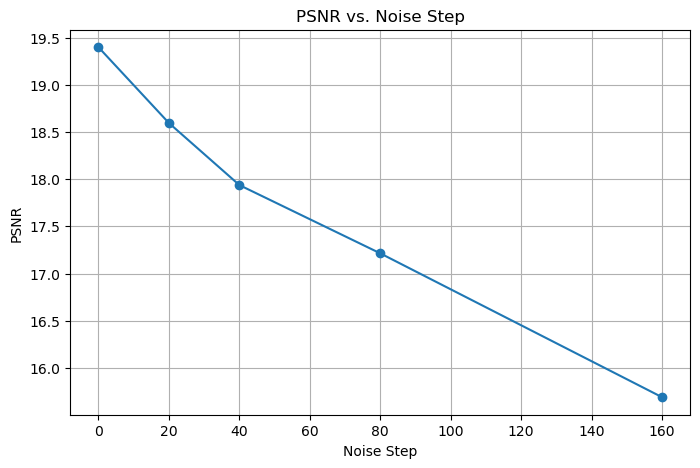

In [26]:

# Define different noise step values
noise_steps = [0, 20, 40, 80, 160]
psnr_values = []
watermarked_img_path = "../output/blackbox_epsilon_testing/epsilon_7.jpg"
secret_labels = [726, 264, 428, 190]
# Run attack for each noise step
for step in noise_steps:
    attacker = DiffWMAttacker(pipe, batch_size=5, noise_step=step, captions={})
    attacked_img_path = f"../output/blackbox_eps7_attacked_{step}.jpg"
    attacker.attack([watermarked_img_path], [attacked_img_path])

    sample_image_org = show_image(original_image_path)
    preprocessed_image_org = preprocess_image(sample_image_org)
    image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)
    
    sample_image_att = show_image(attacked_img_path)
    preprocessed_image = preprocess_image(sample_image_att)
    image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)
    
    original_logits = resnet50.predict(preprocess_input(image_tensor_org))
    attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

    verified, avg_diff = verify_watermark(original_logits, attacked_logits,
                secret_labels )
    print(verified, avg_diff)

    # Compute PSNR
    psnr, _, _ = eval_psnr_ssim_msssim("../output/preprocessed_image.png", attacked_img_path)
    psnr_values.append(psnr)

# Plot PSNR vs. Noise Step
plt.figure(figsize=(8, 5))
plt.plot(noise_steps, psnr_values, marker='o', linestyle='-')
plt.xlabel("Noise Step")
plt.ylabel("PSNR")
plt.title("PSNR vs. Noise Step")
plt.grid()
plt.show()